#Cloning YOLOV10 from github for modiffications and installing packages

In [1]:
!pip install ultralytics
!pip install torch torchvision torchaudio


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 921.5/921.5 kB 36.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 21.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 30.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [2]:
!git clone https://github.com/shiraJacob/Deep_Learning_2025.git


Cloning into 'Deep_Learning_2025'...
remote: Enumerating objects: 625, done.
remote: Counting objects: 100% (625/625), done.
remote: Compressing objects: 100% (474/474), done.
remote: Total 625 (delta 148), reused 595 (delta 138), pack-reused 0 (from 0)
Receiving objects: 100% (625/625), 36.45 MiB | 15.12 MiB/s, done.
Resolving deltas: 100% (148/148), done.


In [3]:
!pip install -q supervision roboflow
!pip install roboflow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.1/83.1 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 11.3 MB/s eta 0:00:00


In [4]:
from roboflow import Roboflow
rf = Roboflow(api_key="iDAVu5fIQ8b91PndHcMI")
project = rf.workspace("image-proccesing-gsjxv").project("tzora_pomogranate_cropped")
version = project.version(16)
dataset = version.download("yolov9")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to tzora_pomogranate_cropped-16 in yolov9:: 100%|██████████| 574/574 [00:00<00:00, 4292.26it/s]


In [5]:
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!echo -e "test: ../test/images\ntrain: ../train/images\nval: ../valid/images" >> {dataset.location}/data.yaml

In [6]:
!pip install albumentations
!pip install opencv-python-headless


#Pre-Proccessing

In [7]:
import os
import cv2
import albumentations as A
from glob import glob

In [8]:
import os
import cv2
import numpy as np

def apply_clahe(image):
    """Applying CLAHE to an image to enhance local contrast."""
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2RGB)

def enhance_saturation(image, saturation_scale=1.3):
    """Enhance the saturation of an image."""
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    h, s, v = cv2.split(hsv_image)
    s = np.clip(s * saturation_scale, 0, 255).astype(np.uint8)
    enhanced_image = cv2.merge([h, s, v])
    return cv2.cvtColor(enhanced_image, cv2.COLOR_HSV2RGB)

def process_images(image_dir):
    """Processing images in a directory with CLAHE and saturation enhancement, then overwrite them."""
    # Loop through all images in the directory
    for filename in os.listdir(image_dir):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_path = os.path.join(image_dir, filename)
            image = cv2.imread(image_path)
            if image is not None:
                image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Apply CLAHE and then enhance saturation
                clahe_image = apply_clahe(image_rgb)
                final_image = enhance_saturation(clahe_image)

                final_image_bgr = cv2.cvtColor(final_image, cv2.COLOR_RGB2BGR)

                # Overwrite and save the original image
                cv2.imwrite(image_path, final_image_bgr)
                print(f"Processed and overwrote {filename}")
            else:
                print(f"Failed to load {filename}")
        else:
            print(f"Skipped {filename}, not an image file")
train_images_path= '/content/tzora_pomogranate_cropped-16/train/images'
process_images(train_images_path)

Processed and overwrote IMG_8448_JPG.rf.c464750ff15fcac2211c10a4df6fa7ff.jpg
Processed and overwrote IMG_8445_JPG.rf.abe455865a2cb1023d009cb65850c844.jpg
Processed and overwrote W1_1_s_jpg.rf.1db84b58ae4e0ea16a9acaffbef5a7e7.jpg
Processed and overwrote IMG_8440_JPG.rf.00d19da228f3574f714a64fb3debce6d.jpg
Processed and overwrote IMG_8508_JPG.rf.5cce7c30880b103fc74e3ecbe05930c4.jpg
Processed and overwrote IMG_8442_JPG.rf.5b2a31cd7eab39dc5aa736dd51924a54.jpg
Processed and overwrote IMG_8482_JPG.rf.c8aafead3df0c21fecebda5f61e76b72.jpg
Processed and overwrote IMG_8436_JPG.rf.226d9397fa28b90e8179179577fa1c95.jpg
Processed and overwrote IMG_8582_JPG.rf.6a72820954dbe10e97b119e57891a045.jpg
Processed and overwrote IMG_8440_JPG.rf.6124aced11de412729fca09a4b109604.jpg
Processed and overwrote R2_1_d_jpg.rf.bd016300ca23fc0db9e3d41663a8f610.jpg
Processed and overwrote BE3_1_d_jpg.rf.ce9a8349a41dbdb688a700f0c11d1738.jpg
Processed and overwrote Y5_1_d_jpg.rf.651ab7cf39221e154961fca719aa9ca1.jpg
Proces

In [9]:
#check number of images in the training set
from glob import glob  # Import the glob function

image_count = len(glob(train_images_path + "/*.jpg"))
print("Number of images in train_images_path:", image_count)


Number of images in train_images_path: 246


In [10]:
#appling pre-proccessing to the valid and test set
valid_images_path= '/content/tzora_pomogranate_cropped-16/valid/images'
process_images(valid_images_path)

test_images_path= '/content/tzora_pomogranate_cropped-16/test/images'
process_images(test_images_path)

Processed and overwrote BK5_1_d_jpg.rf.c1ec8aa2a4a68309b052b571ec2ed2ea.jpg
Processed and overwrote BK2_1_d_jpg.rf.4570c04cb5d18324cbe23624ff746d0a.jpg
Processed and overwrote IMG_8483_JPG.rf.570ff19ab73bf8ea11fea75c948076d8.jpg
Processed and overwrote IMG_8466_JPG.rf.11a4bf6030922adc393637ebb8ecfa3a.jpg
Processed and overwrote W4_1_s_jpg.rf.43d975a302d88de0ddba68cc7f17042d.jpg
Processed and overwrote BE6_1_d_jpg.rf.71ec80c4eb50930ad25a64ae7e1c6204.jpg
Processed and overwrote IMG_8463_JPG.rf.33ca5c4c11d505e6b9df6deb52f708e5.jpg
Processed and overwrote IMG_8468_JPG.rf.92d5b2f5da325f41d216a723789a9b38.jpg
Processed and overwrote Y6_1_s_jpg.rf.ccb3208c39bbeb0f958903aa70cf3818.jpg
Processed and overwrote W4_1_d_jpg.rf.c734032844d2e6ab67f3da097b97db4c.jpg
Processed and overwrote R2_1_s_jpg.rf.f9267ed13c9965b6ec7fec0e8f01e21c.jpg
Processed and overwrote W3_2_d_jpg.rf.6ef68044d31d7245c1a042cdb4dccf6f.jpg
Processed and overwrote IMG_8453_JPG.rf.6bbb8c3716364fbccc7ac8203398bcab.jpg
Processed an

In [11]:
#adding Color and Intensity Transformations, Noise Addition and Blurring for augmentation

augmentation_pipeline = A.Compose([
    A.OneOf([
        A.GaussNoise(p=0.5),
        A.Blur(blur_limit=3, p=0.5),
    ], p=0.5),
    A.RandomBrightnessContrast(p=0.5),

])

In [12]:
import os
import cv2
from glob import glob
#functions for augumenting and saving the augumantations

# Function to Read and Write Label Files:
def read_label_file(label_path):
    with open(label_path, 'r') as file:
        return file.readlines()

def write_label_file(label_path, content):
    with open(label_path, 'w') as file:
        file.writelines(content)

def save_image_and_label(image, filename, suffix, image_dir, label_dir):
    # paths for augmented image and label
    aug_image_path = os.path.join(image_dir, filename.replace('.jpg', f'_{suffix}.jpg'))
    aug_label_path = os.path.join(label_dir, filename.replace('.jpg', f'_{suffix}.txt'))

    os.makedirs(os.path.dirname(aug_image_path), exist_ok=True)
    os.makedirs(os.path.dirname(aug_label_path), exist_ok=True)

    # Save augmented image
    cv2.imwrite(aug_image_path, image)

    # Save label if exists
    label_path = os.path.join(label_dir, filename.replace('.jpg', '.txt'))
    if os.path.exists(label_path):
        label_content = read_label_file(label_path)
        write_label_file(aug_label_path, label_content)
    else:
        print(f"Label not found for image {filename}")

#augment_and_save images before trainig
def augment_and_save(image_dir, label_dir):
    for image_path in glob(os.path.join(image_dir, '*.jpg')):
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        filename = os.path.basename(image_path)

        augmented = augmentation_pipeline(image=image)['image']

        # Save augmented image and corresponding label with a suffix to indicate augmentation
        save_image_and_label(augmented, filename, 'augmented', image_dir, label_dir)

    print("Augmentation and saving completed.")



image_dir = '/content/tzora_pomogranate_cropped-16/train/images'
label_dir = '/content/tzora_pomogranate_cropped-16/train/labels/'

augment_and_save(image_dir, label_dir)


Augmentation and saving completed.


In [13]:
#check number of images in the training set after agumentation

image_count = len(glob(train_images_path + "/*.jpg"))
print("Number of images in train_images_path:", image_count)


Number of images in train_images_path: 492


#Hyper Parameter Tuning and Training

In [14]:

from ultralytics import YOLO
import yaml

yaml_file = '/content/tzora_pomogranate_cropped-16/data.yaml'
model_weights = '/content/weights/yolov10s.pt'  #
#model_weights = '/content/yolo_trained_new_data_7_01_2024.pt'  # Path for trained wheights uploaded from previous training
# Load the YOLO model
model = YOLO(model_weights)
# Tune the model and use the tuned parameters directly for training
model.tune(data=yaml_file, epochs=15, iterations=15, optimizer='AdamW', plots=False, save=False, val=False)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 15.9M/15.9M [00:00<00:00, 59.8MB/s]

Tuner: Initialized Tuner instance with 'tune_dir=runs/detect/tune'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/15 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'copy_paste': 0.0}


Saved runs/detect/tune/tune_scatter_plots.png
Saved runs/detect/tune/tune_fitness.png

Tuner: 1/15 iterations complete ✅ (281.63s)
Tuner: Results saved to runs/detect/tune
Tuner: Best fitness=0.25337 observed at iteration 1
Tuner: Best fitness metrics are {'metrics/precision(B)': 0.60707, 'metrics/recall(B)': 0.40305, 'metrics/mAP50(B)': 0.4673, 'metrics/mAP50-95(B)': 0.2296, 'val/box_loss': 3.87114, 'val/cls_loss': 2.35201, 'val/dfl_loss': 1.95619, 'fitness': 0.25337}
Tuner: Best fitness model is runs/detect/train
Tuner: Best fitness hyperparameters are printed below.

Printing 'runs/detect/tune/best_hyperparameters.yaml'

lr0: 0.01
lrf: 0.01
momentum: 0.937
weight_decay: 0.0005
warmup_epochs: 3.0
warmup_momentum: 0.8
box: 7.5
cls: 0.5
dfl: 1.5
hsv_h: 0.015
hsv_s: 0.7
hsv_v: 0.4
degrees: 0.0
translate: 0.1
scale: 0.5
shear: 0.0
perspective: 0.0
flipud: 0.0
fliplr: 0.5
bgr: 0.0
mosaic: 1.0
mixup: 0.0
copy_paste: 0.0

Tuner: Starting iteration 2/15 with hyperparameters: {'lr0': 0.01265,

In [15]:
from ultralytics import YOLO
import yaml

with open('runs/detect/tune/best_hyperparameters.yaml', 'r', encoding='utf-8') as file:
    tuned_params = yaml.safe_load(file)

#Create a dictionary with the relevant parameters for training
valid_params = {
    'lr0': tuned_params.get('lr0'),
    'lrf': tuned_params.get('lrf'),
    'momentum': tuned_params.get('momentum'),
    'weight_decay': tuned_params.get('weight_decay'),
    'warmup_epochs': tuned_params.get('warmup_epochs'),
    'warmup_momentum': tuned_params.get('warmup_momentum'),
    'box': tuned_params.get('box'),
    'cls': tuned_params.get('cls'),
    'dfl': tuned_params.get('dfl'),
    'hsv_h': tuned_params.get('hsv_h'),
    'hsv_s': tuned_params.get('hsv_s'),
    'hsv_v': tuned_params.get('hsv_v'),
    'degrees': tuned_params.get('degrees'),
    'translate': tuned_params.get('translate'),
    'scale': tuned_params.get('scale'),
    'shear': tuned_params.get('shear'),
    'perspective': tuned_params.get('perspective'),
    'flipud': tuned_params.get('flipud'),
    'fliplr': tuned_params.get('fliplr'),
    'bgr': tuned_params.get('bgr'),
    'mosaic': tuned_params.get('mosaic'),
    'mixup': tuned_params.get('mixup'),
    'copy_paste': tuned_params.get('copy_paste')
}


# Print the valid parameters to check the values
print(valid_params)
yaml_file='/content/tzora_pomogranate_cropped-16/data.yaml'
model = YOLO(model_weights)

# Train the model using the tuned parameters
model.train(data=yaml_file,
            epochs=50,
            **valid_params,
            plots=True,
            save=True,
            single_cls=True)

{'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'copy_paste': 0.0}
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/content/weights/yolov10s.pt, data=/content/tzora_pomogranate_cropped-16/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train16, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=True, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, d

train: Scanning /content/tzora_pomogranate_cropped-16/train/labels.cache... 492 images, 0 backgrounds, 0 corrupt: 100%|██████████| 492/492 [00:00<?, ?it/s]

train: WARNING ⚠️ /content/tzora_pomogranate_cropped-16/train/images/IMG_8484_JPG.rf.757bfedcbcc1027047d53c50b67bcb2b.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/tzora_pomogranate_cropped-16/train/images/IMG_8484_JPG.rf.757bfedcbcc1027047d53c50b67bcb2b_augmented.jpg: 1 duplicate labels removed
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/tzora_pomogranate_cropped-16/valid/labels.cache... 17 images, 0 backgrounds, 0 corrupt: 100%|██████████| 17/17 [00:00<?, ?it/s]


Plotting labels to runs/detect/train16/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 99 weight(decay=0.0), 112 weight(decay=0.0005), 111 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train16
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      8.69G      5.319      5.092      2.453       1393        640: 100%|██████████| 31/31 [00:18<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all         17       1842      0.195      0.484      0.223      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      9.58G      4.733      2.732      2.181       1320        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]

                   all         17       1842      0.607      0.423      0.461      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      7.01G      4.699      2.675      2.172       1578        640: 100%|██████████| 31/31 [00:16<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         17       1842      0.569      0.426      0.454      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      9.96G      4.703       2.64      2.152       1664        640: 100%|██████████| 31/31 [00:16<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all         17       1842       0.61      0.454      0.506      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50        11G      4.638      2.618      2.151       1481        640: 100%|██████████| 31/31 [00:16<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         17       1842       0.57      0.474      0.488      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      8.12G      4.558      2.547      2.117       1276        640: 100%|██████████| 31/31 [00:15<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]

                   all         17       1842      0.579      0.498      0.528      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      8.85G      4.481      2.497      2.096       1613        640: 100%|██████████| 31/31 [00:16<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         17       1842      0.677      0.471      0.554      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      8.38G       4.45      2.434       2.07       1516        640: 100%|██████████| 31/31 [00:16<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         17       1842      0.631      0.495      0.543      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      10.2G      4.426      2.448      2.068       2227        640: 100%|██████████| 31/31 [00:15<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]

                   all         17       1842      0.552      0.397      0.424      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      8.47G      4.436      2.447      2.075       1626        640: 100%|██████████| 31/31 [00:15<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         17       1842      0.679       0.51      0.583      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      9.04G      4.307      2.444      2.073        952        640: 100%|██████████| 31/31 [00:15<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all         17       1842      0.709      0.491      0.585        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       9.2G      4.308      2.384      2.051       1922        640: 100%|██████████| 31/31 [00:16<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]

                   all         17       1842       0.71      0.492      0.582      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      7.66G      4.255      2.353      2.052       1446        640: 100%|██████████| 31/31 [00:15<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all         17       1842      0.693      0.473      0.568      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.89G      4.224      2.306      2.028       1328        640: 100%|██████████| 31/31 [00:16<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         17       1842       0.75      0.473      0.587      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.28G      4.209       2.31      2.007       1778        640: 100%|██████████| 31/31 [00:16<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all         17       1842      0.764      0.519      0.622      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.79G      4.197      2.301      2.017       1662        640: 100%|██████████| 31/31 [00:15<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]

                   all         17       1842      0.741      0.492      0.605      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      10.1G      4.116      2.256      2.008       1396        640: 100%|██████████| 31/31 [00:16<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         17       1842      0.686      0.521        0.6      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.85G       4.08      2.222      1.992       1776        640: 100%|██████████| 31/31 [00:16<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         17       1842      0.735      0.529      0.631      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      8.28G       4.21      2.288      1.995       2335        640: 100%|██████████| 31/31 [00:16<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         17       1842      0.779      0.501      0.618       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      9.19G      4.086      2.254      1.999       1233        640: 100%|██████████| 31/31 [00:15<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all         17       1842      0.679      0.481      0.564      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      9.61G      4.134      2.251      1.989       1904        640: 100%|██████████| 31/31 [00:16<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]

                   all         17       1842      0.717       0.51      0.605      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      8.01G      4.033      2.207      1.977       1628        640: 100%|██████████| 31/31 [00:15<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         17       1842       0.72      0.526      0.621      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      10.2G       4.07      2.217      1.983       1721        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         17       1842      0.777      0.502      0.619       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      8.31G      4.061      2.217      1.982       1457        640: 100%|██████████| 31/31 [00:16<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         17       1842      0.789      0.497      0.623      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      8.37G      4.079       2.19      1.982       1512        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all         17       1842      0.753      0.517      0.628      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      8.25G      3.998      2.149      1.971       1717        640: 100%|██████████| 31/31 [00:16<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         17       1842      0.736      0.528      0.626      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50       8.8G      3.995      2.169      1.971       1475        640: 100%|██████████| 31/31 [00:16<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         17       1842      0.735      0.533      0.634      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.88G       3.98      2.126      1.954       2051        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all         17       1842      0.767      0.521      0.636      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      8.23G      3.931      2.132      1.962       1650        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         17       1842      0.767      0.533      0.644      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      10.4G      3.894      2.103      1.962       1486        640: 100%|██████████| 31/31 [00:15<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]

                   all         17       1842      0.699       0.52      0.605      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      8.19G      3.919       2.08      1.944       1417        640: 100%|██████████| 31/31 [00:16<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all         17       1842      0.775      0.533      0.645       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.24G      3.914       2.08      1.943       1613        640: 100%|██████████| 31/31 [00:16<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         17       1842      0.747      0.539      0.638      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      10.5G      3.895        2.1      1.944       1335        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         17       1842      0.732      0.564      0.649      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.57G      3.904      2.071       1.94       1277        640: 100%|██████████| 31/31 [00:16<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.62it/s]

                   all         17       1842      0.718       0.54      0.623      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.82G      3.838      2.049      1.937       1527        640: 100%|██████████| 31/31 [00:15<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all         17       1842      0.748      0.541      0.644      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.1G      3.803      2.009      1.924       1970        640: 100%|██████████| 31/31 [00:16<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         17       1842        0.8       0.53      0.652      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      9.46G      3.817      2.003      1.923       1484        640: 100%|██████████| 31/31 [00:16<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]

                   all         17       1842      0.773      0.539      0.649      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      9.58G      3.783      2.019      1.928       1050        640: 100%|██████████| 31/31 [00:15<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         17       1842      0.778      0.528      0.647       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      10.7G      3.787      2.019      1.922       1601        640: 100%|██████████| 31/31 [00:15<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         17       1842      0.745      0.539      0.645      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      8.42G      3.758      1.995      1.922       2132        640: 100%|██████████| 31/31 [00:16<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all         17       1842       0.74       0.55      0.647      0.353


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      5.66G      3.716      2.034      1.984       1021        640: 100%|██████████| 31/31 [00:15<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         17       1842      0.745       0.53      0.632      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.26G      3.703      2.006      1.968       1073        640: 100%|██████████| 31/31 [00:13<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]

                   all         17       1842      0.763      0.513      0.633      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       6.6G      3.679          2       1.96       1119        640: 100%|██████████| 31/31 [00:13<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         17       1842      0.733      0.529      0.631      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      7.61G      3.684       1.97      1.956        924        640: 100%|██████████| 31/31 [00:13<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         17       1842      0.742      0.517      0.626      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.84G      3.636      1.957      1.943       1319        640: 100%|██████████| 31/31 [00:13<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all         17       1842      0.779      0.523      0.645      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.94G      3.597      1.954       1.94       1292        640: 100%|██████████| 31/31 [00:13<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         17       1842      0.731      0.549      0.642      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.55G      3.603      1.944      1.951       1160        640: 100%|██████████| 31/31 [00:13<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]

                   all         17       1842       0.78      0.537      0.655      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      5.66G      3.563      1.921      1.938       1043        640: 100%|██████████| 31/31 [00:13<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         17       1842      0.757      0.553      0.659      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.01G      3.539      1.916      1.934       1292        640: 100%|██████████| 31/31 [00:13<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]

                   all         17       1842      0.762      0.548      0.657      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.53G      3.516      1.893      1.935       1163        640: 100%|██████████| 31/31 [00:13<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         17       1842       0.79      0.539      0.655      0.367



50 epochs completed in 0.251 hours.
Optimizer stripped from runs/detect/train16/weights/last.pt, 16.5MB
Optimizer stripped from runs/detect/train16/weights/best.pt, 16.5MB

Validating runs/detect/train16/weights/best.pt...
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv10s summary (fused): 129 layers, 8,036,508 parameters, 0 gradients, 24.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]


                   all         17       1842      0.756      0.554      0.659      0.368
              defected         17       1842      0.756      0.554      0.659      0.368
Speed: 0.2ms preprocess, 5.4ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/train16


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7bc0b76cebd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

#Detection visualisation


0: 640x640 7 defecteds, 53 pomegranatess, 17.5ms
Speed: 4.0ms preprocess, 17.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/Y3_1_s_jpg.rf.47cd48fa1a5165165cb37d29859d205d.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


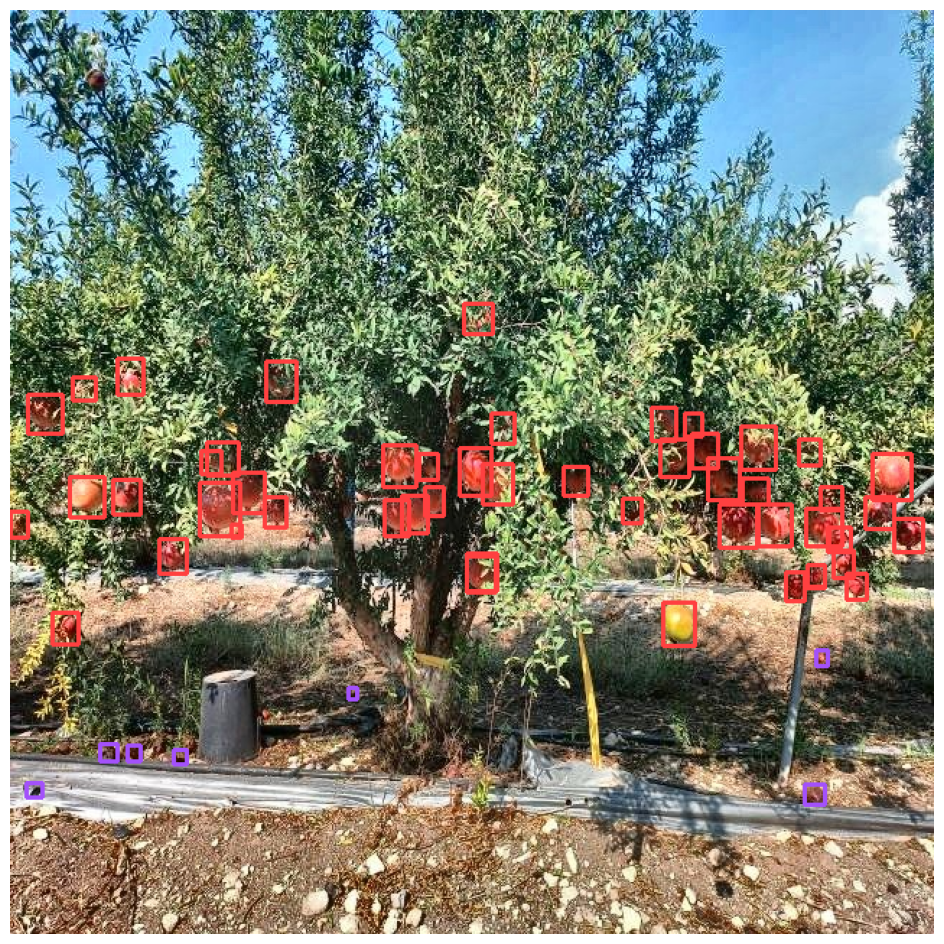


0: 640x640 26 defecteds, 97 pomegranatess, 20.9ms
Speed: 3.1ms preprocess, 20.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8530_JPG.rf.894e8237a701a2519992870e1058cf46.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


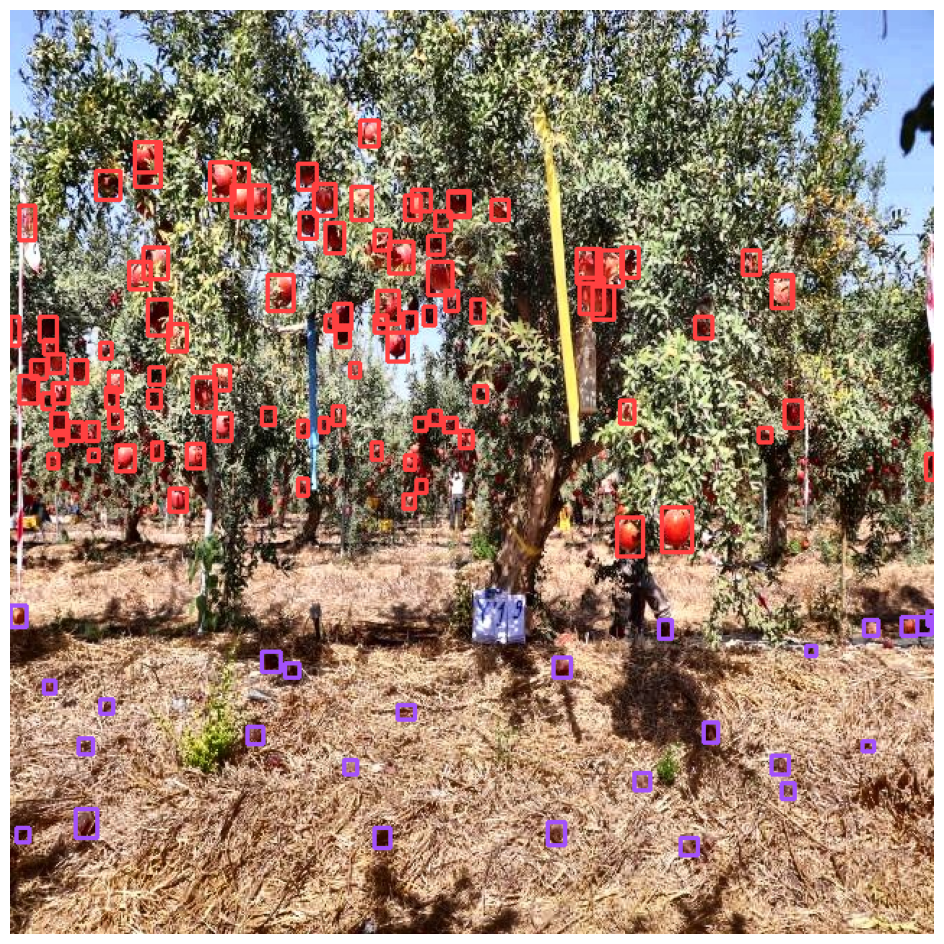


0: 640x640 28 pomegranatess, 19.7ms
Speed: 2.8ms preprocess, 19.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/BK5_1_s_jpg.rf.3919637ca4ef2e472cf783d7c11c43df.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


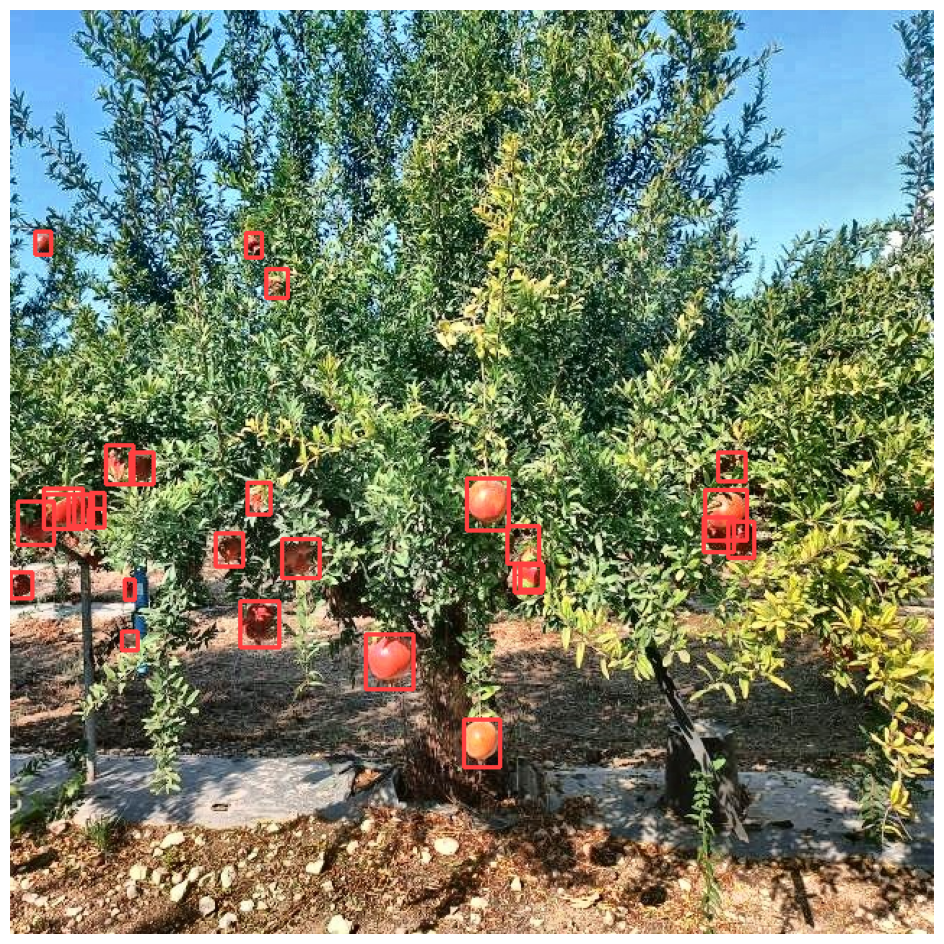


0: 640x640 6 defecteds, 105 pomegranatess, 30.8ms
Speed: 2.9ms preprocess, 30.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8474_JPG.rf.3af123b151bd4d360a45a5789cfdb0fe.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


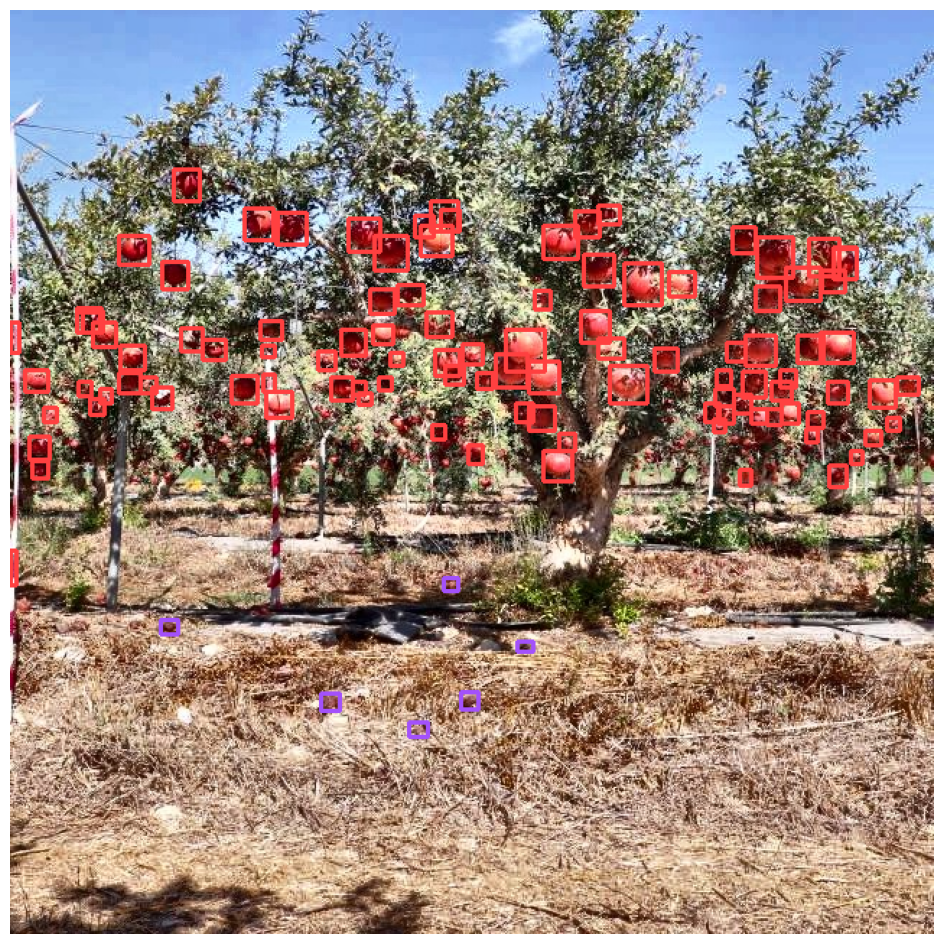


0: 640x640 12 defecteds, 105 pomegranatess, 18.9ms
Speed: 3.3ms preprocess, 18.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8460_JPG.rf.24920622752e0e4f8df2e469d855d7ee.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


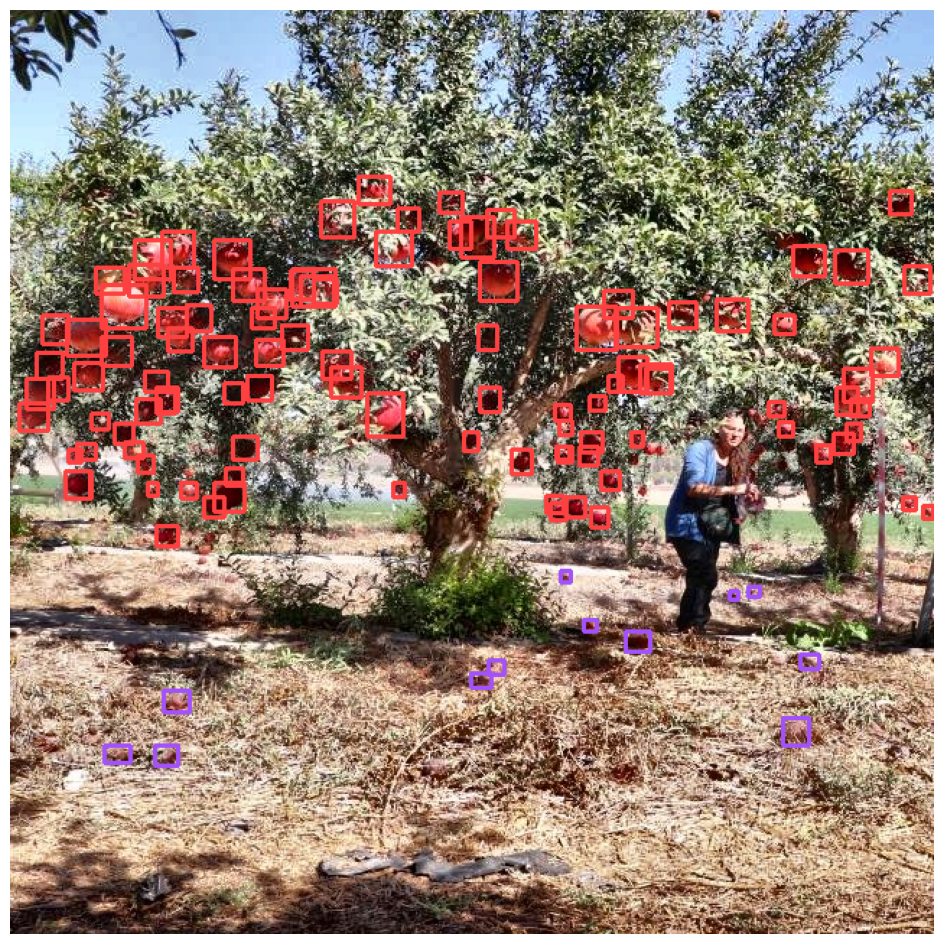


0: 640x640 5 defecteds, 125 pomegranatess, 21.0ms
Speed: 3.1ms preprocess, 21.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8479_JPG.rf.e13327ee95de0b7f74fc1489f2fccdd3.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


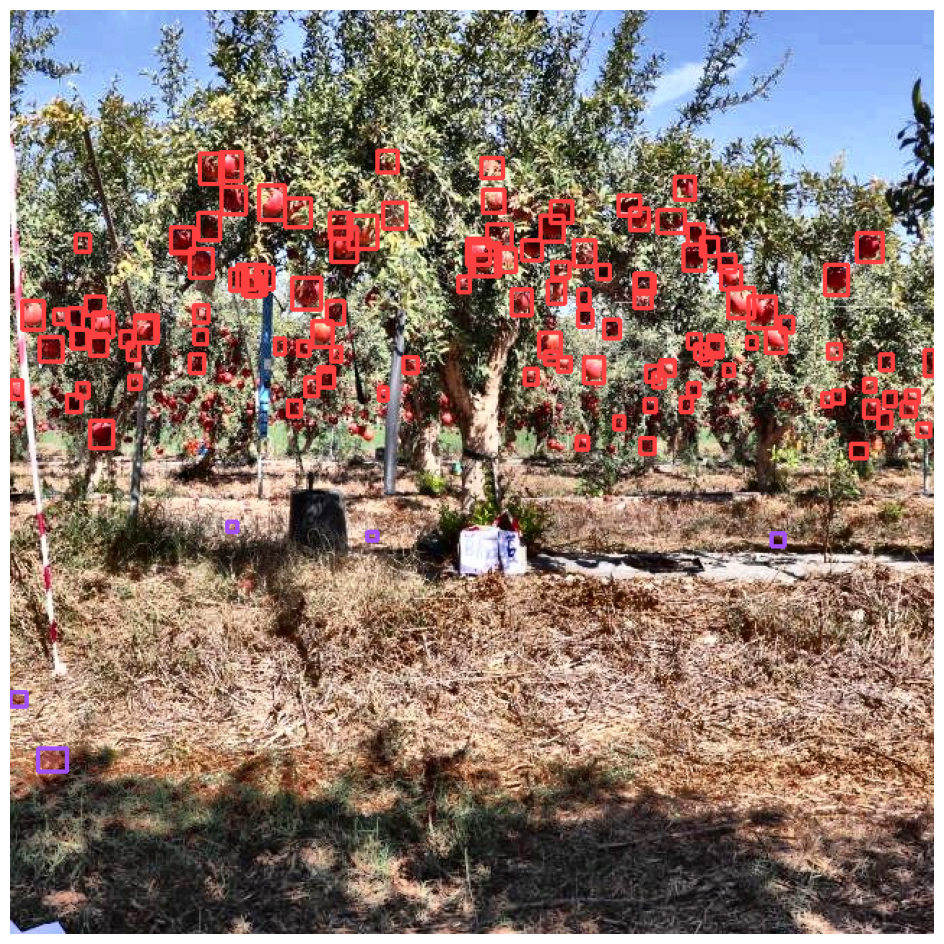


0: 640x640 2 defecteds, 46 pomegranatess, 17.7ms
Speed: 4.8ms preprocess, 17.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/BE3_1_s_jpg.rf.f57ebb9de92c35b27e27c391243d6df0.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


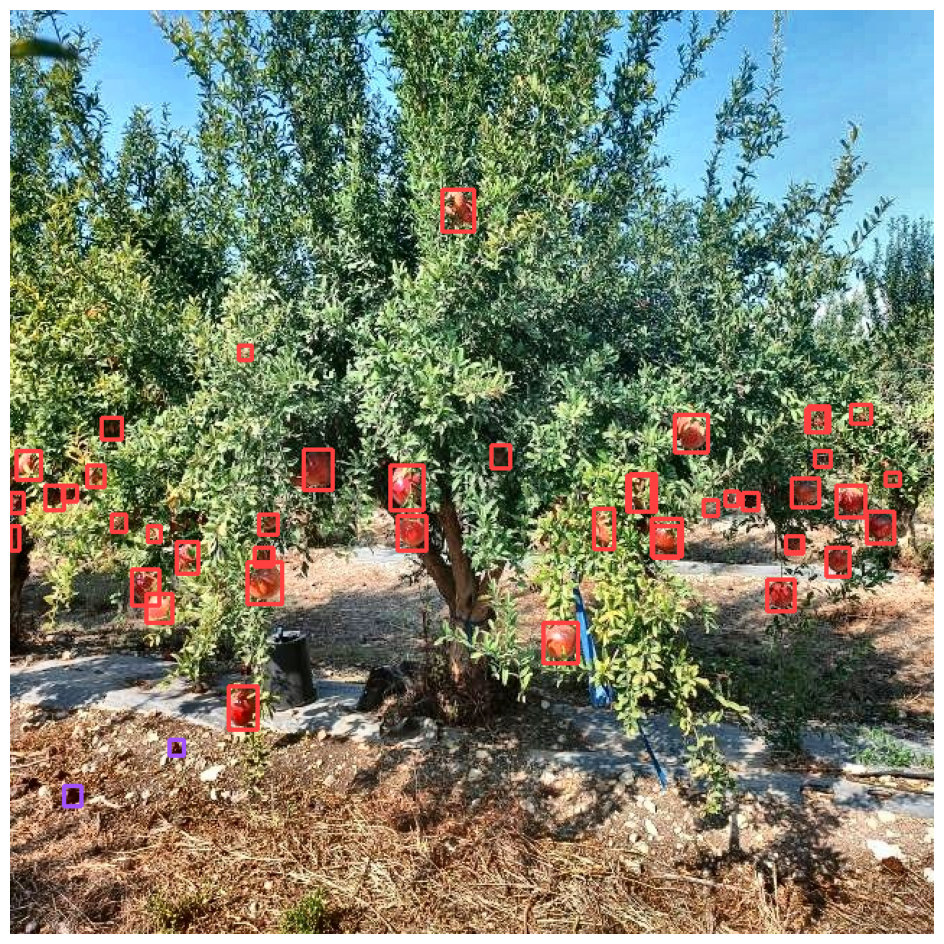


0: 640x640 2 defecteds, 62 pomegranatess, 18.2ms
Speed: 3.0ms preprocess, 18.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/BK3_1_s_jpg.rf.33e156c978fd16e4f010df00b951c58d.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


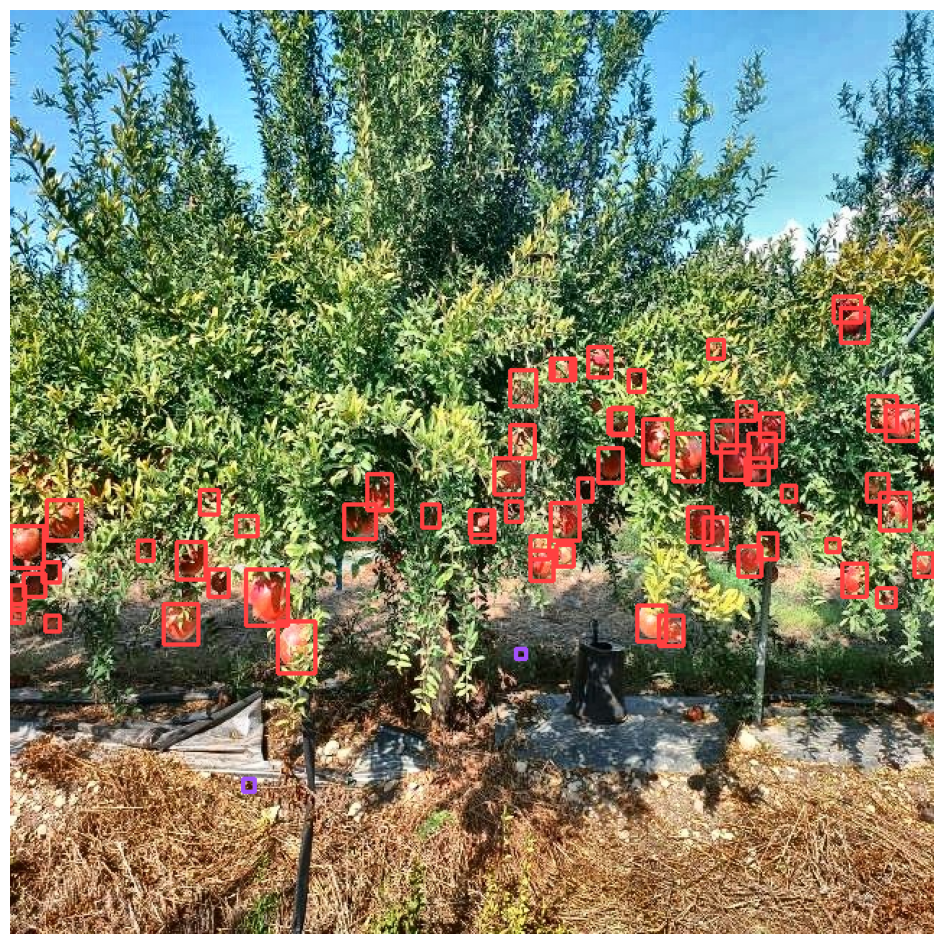


0: 640x640 10 defecteds, 60 pomegranatess, 17.5ms
Speed: 3.0ms preprocess, 17.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/Y1_1_s_jpg.rf.9c46fe3c6998be637cb10618c90a64d7.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


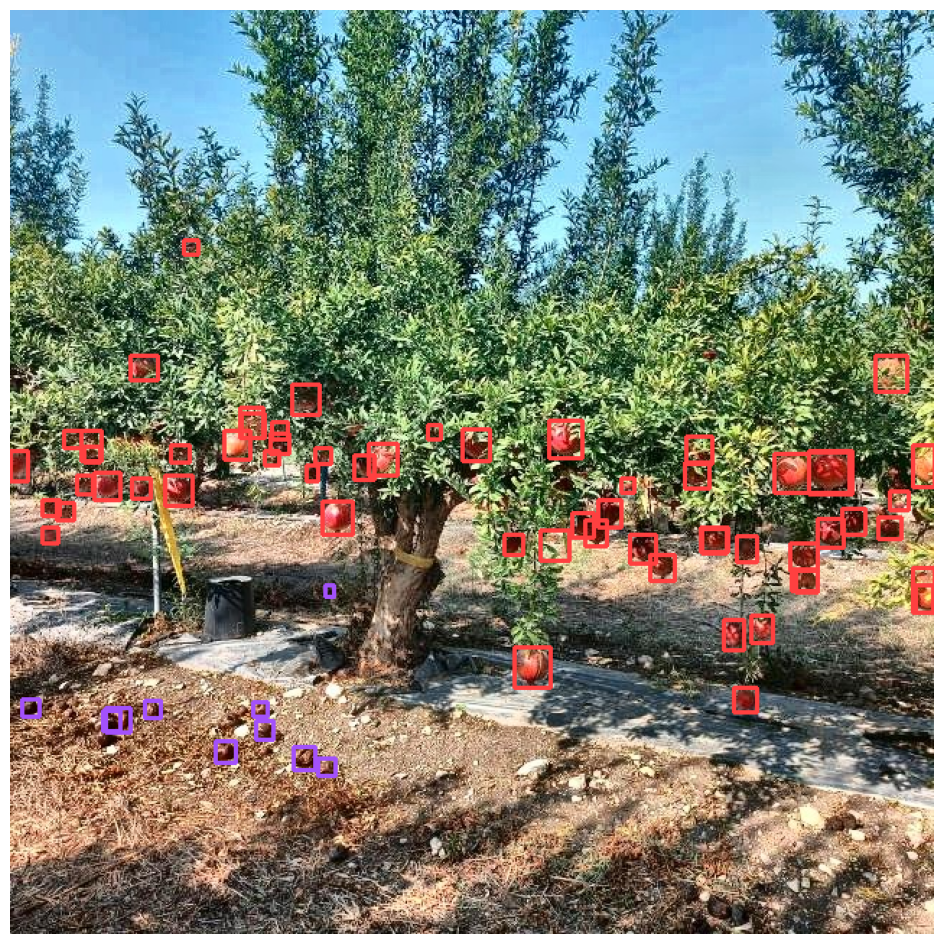


0: 640x640 22 defecteds, 95 pomegranatess, 18.2ms
Speed: 3.1ms preprocess, 18.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8516_JPG.rf.e418a13065c12b1a0fa984ba54196b55.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


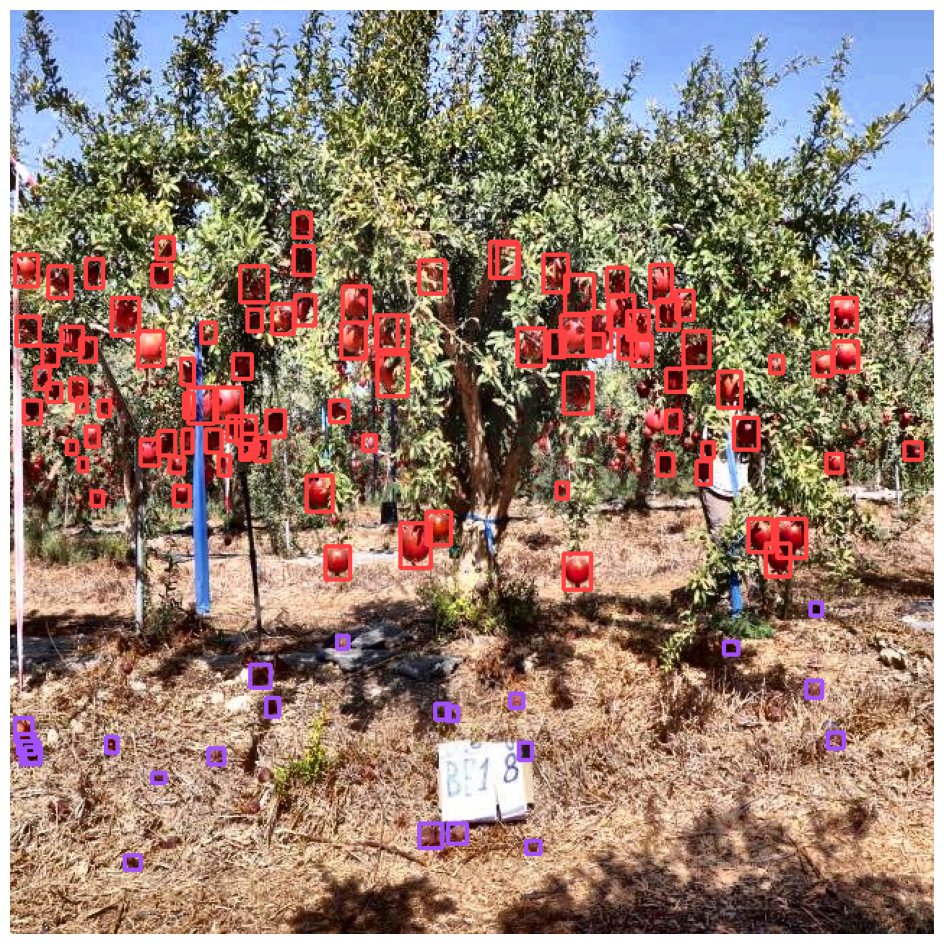


0: 640x640 5 defecteds, 121 pomegranatess, 17.6ms
Speed: 2.9ms preprocess, 17.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8455_JPG.rf.483642f13f60c58d1ce855fdd3e72b47.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


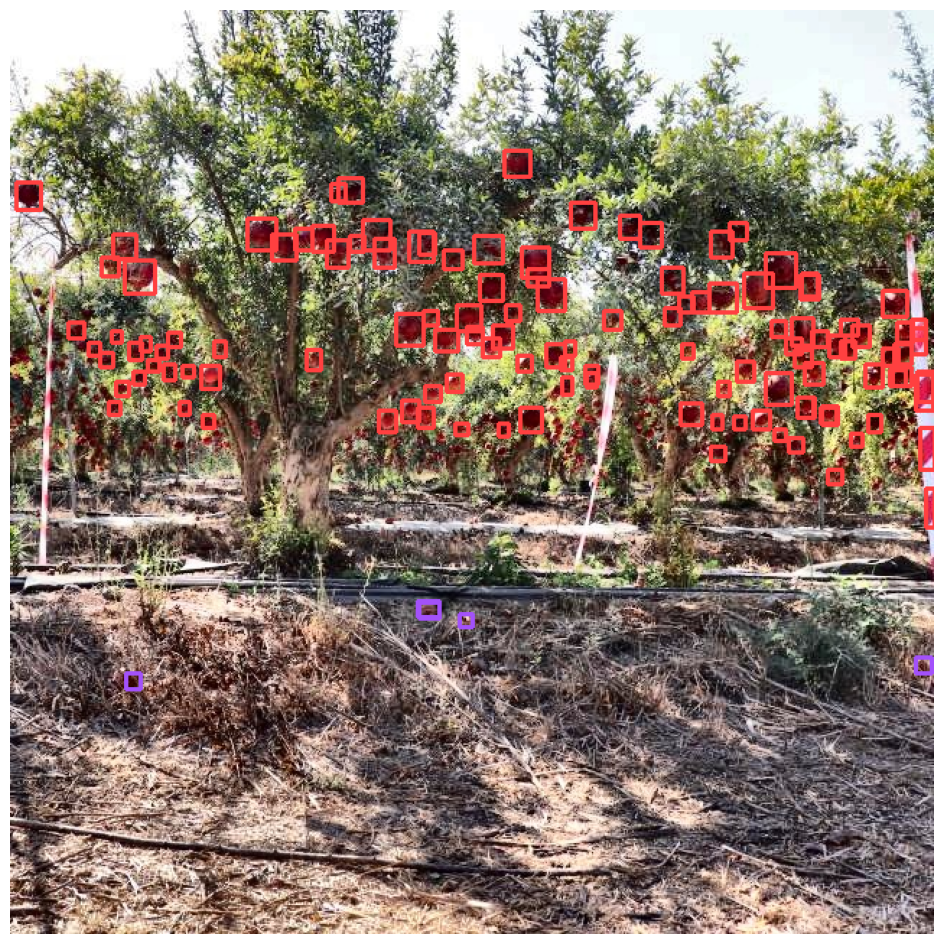


0: 640x640 4 defecteds, 65 pomegranatess, 21.3ms
Speed: 2.8ms preprocess, 21.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/W2_1_s_jpg.rf.396a06fe71c73037b1828801590d9cac.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


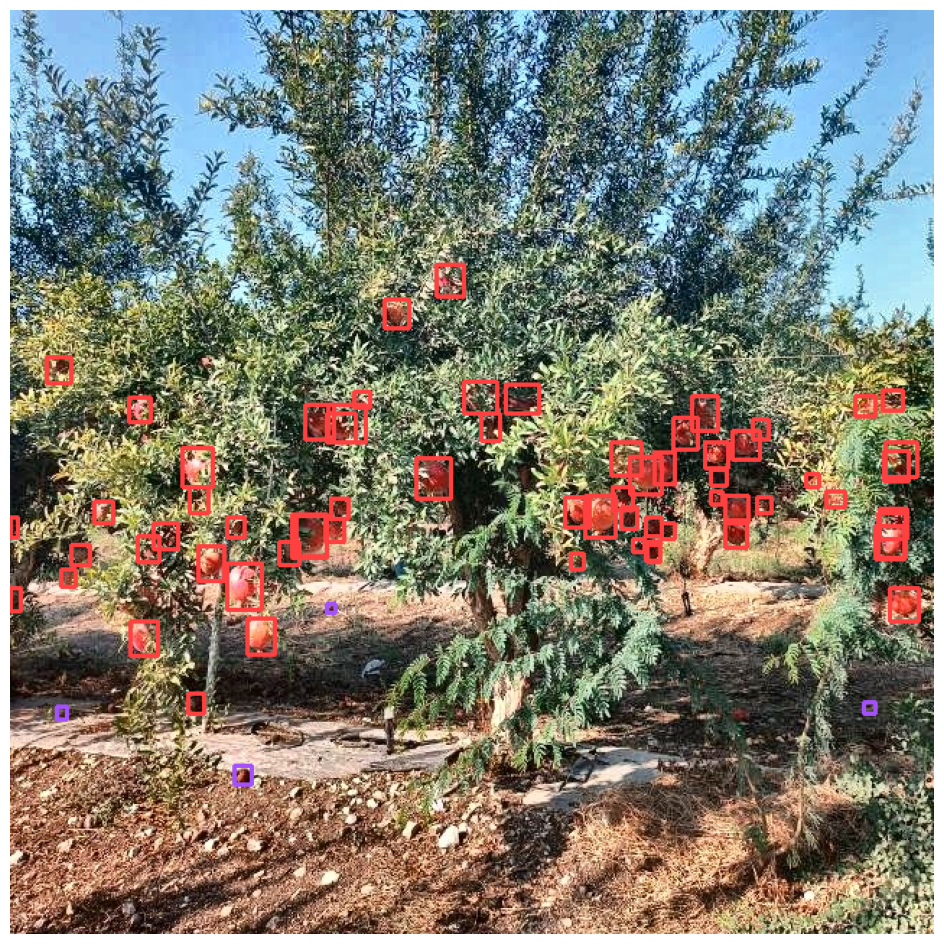


0: 640x640 3 defecteds, 59 pomegranatess, 21.1ms
Speed: 2.8ms preprocess, 21.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/BE1_1_s_jpg.rf.433c155ce8b8a0fdcbaa25a667cdd91f.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


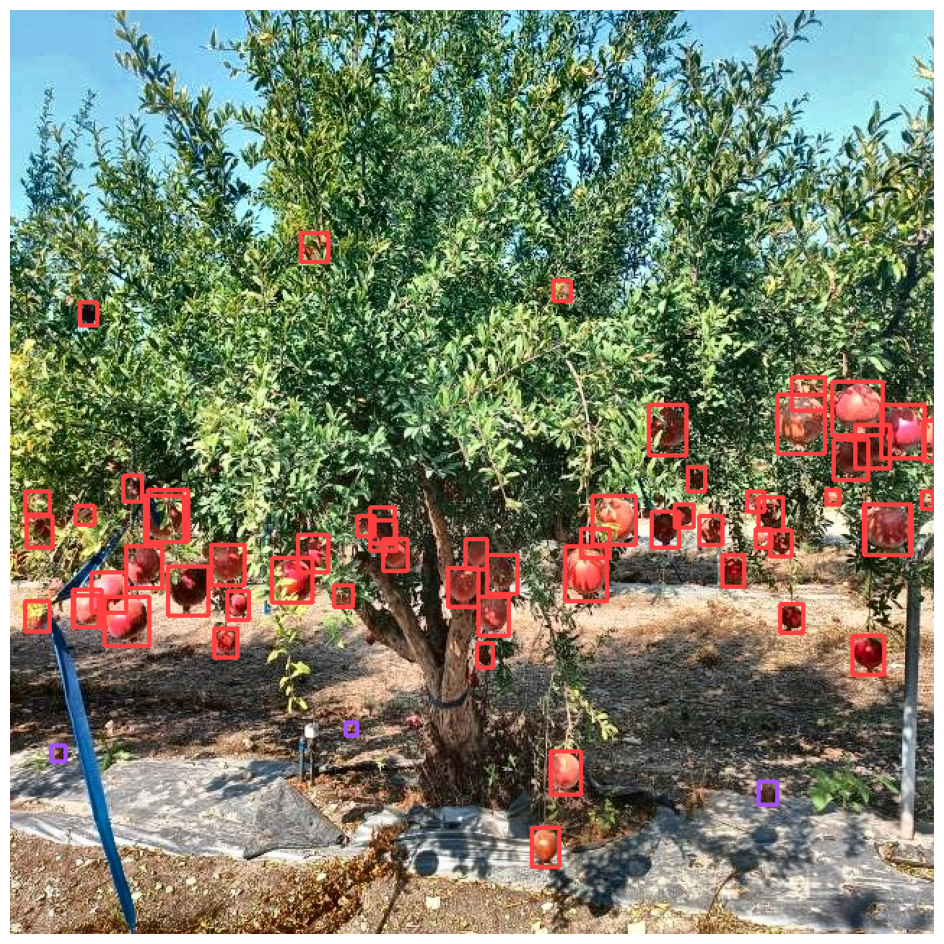


0: 640x640 3 defecteds, 43 pomegranatess, 17.6ms
Speed: 3.0ms preprocess, 17.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/Y3_1_d_jpg.rf.ee738a6b7764770fbef579050e185a9d.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


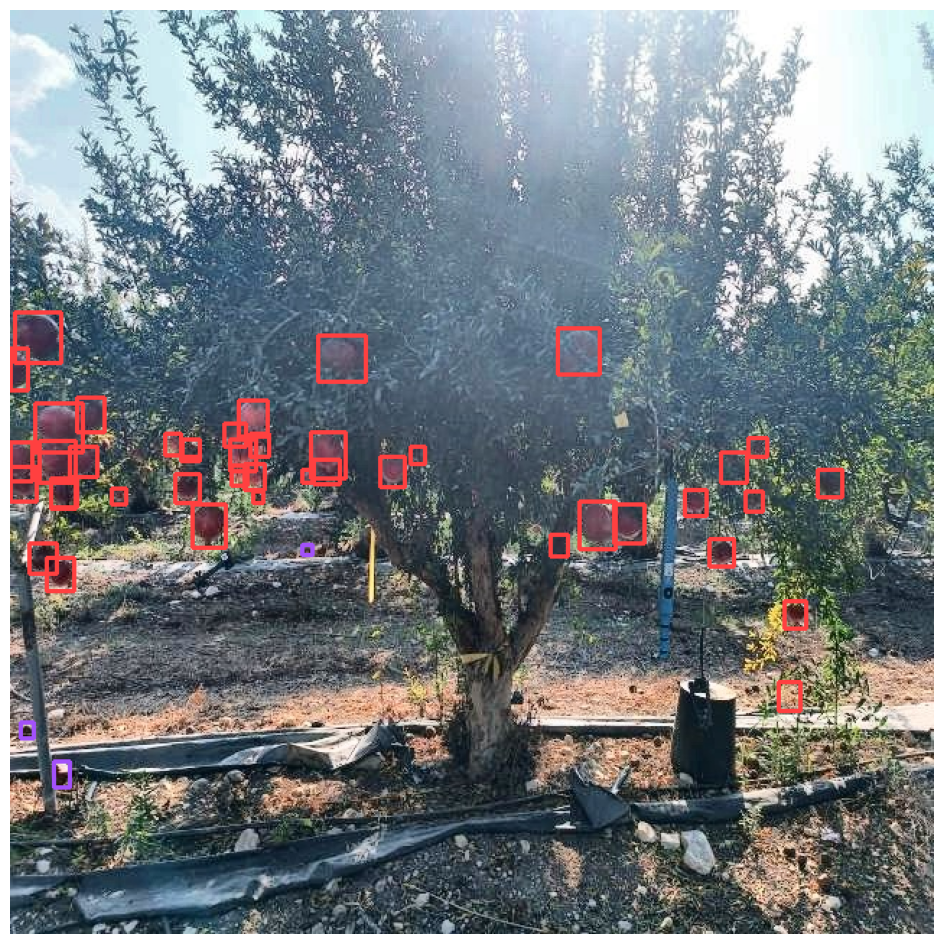


0: 640x640 7 defecteds, 81 pomegranatess, 18.9ms
Speed: 3.0ms preprocess, 18.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/BE6_1_s_jpg.rf.842315520c0943f58afddc87e7f8deee.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


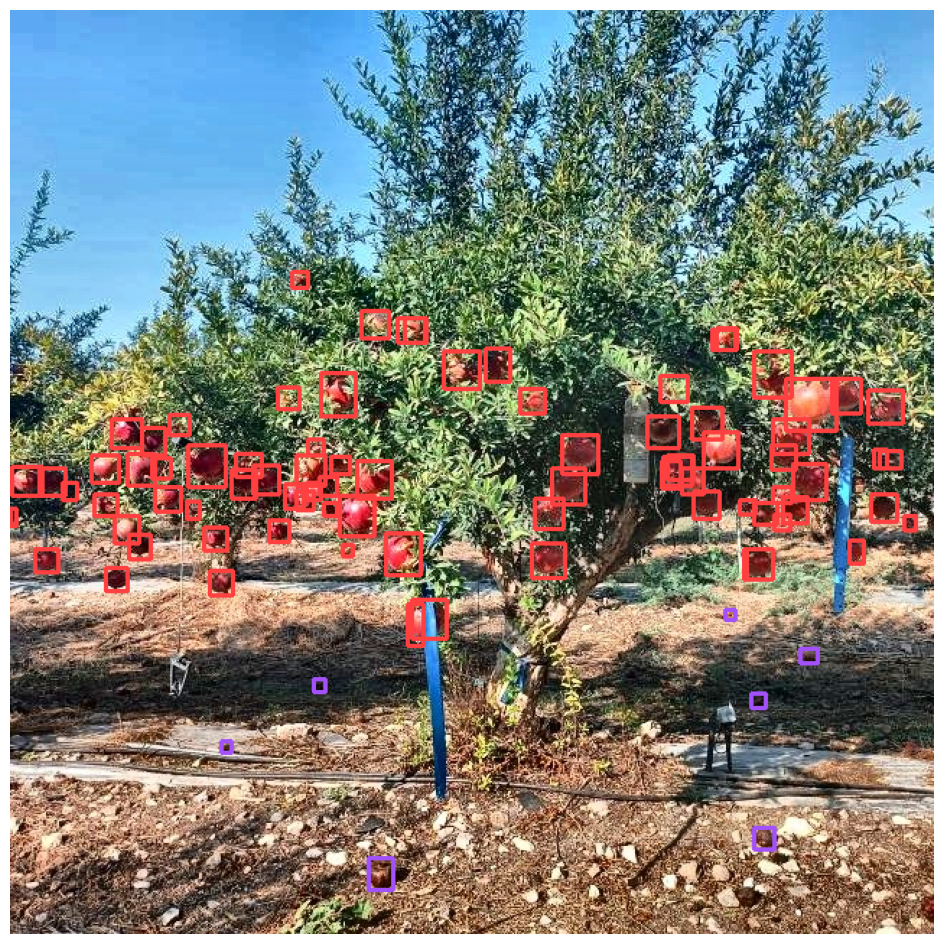


0: 640x640 13 defecteds, 165 pomegranatess, 17.5ms
Speed: 2.9ms preprocess, 17.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8471_JPG.rf.713b0bd3931c60742d50132a43a75f08.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


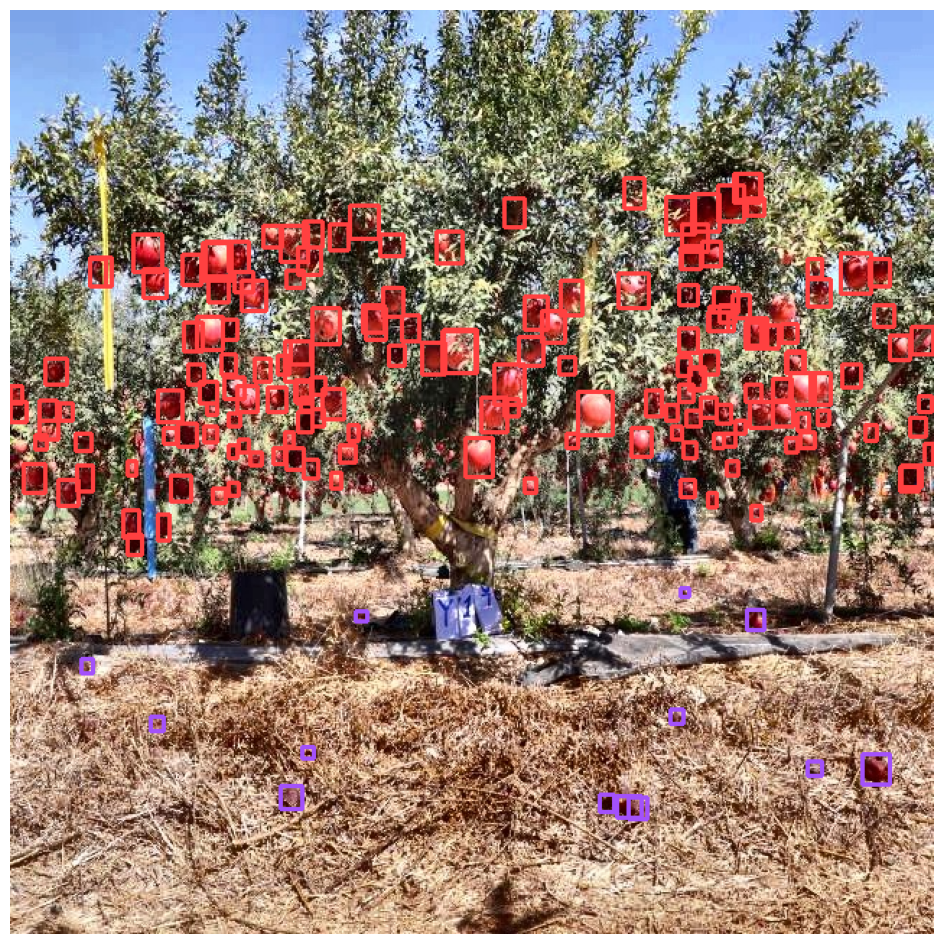


0: 640x640 2 defecteds, 123 pomegranatess, 17.5ms
Speed: 3.5ms preprocess, 17.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8480_JPG.rf.64e31fa2dbe17d9a9e9be0446f3cbe90.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


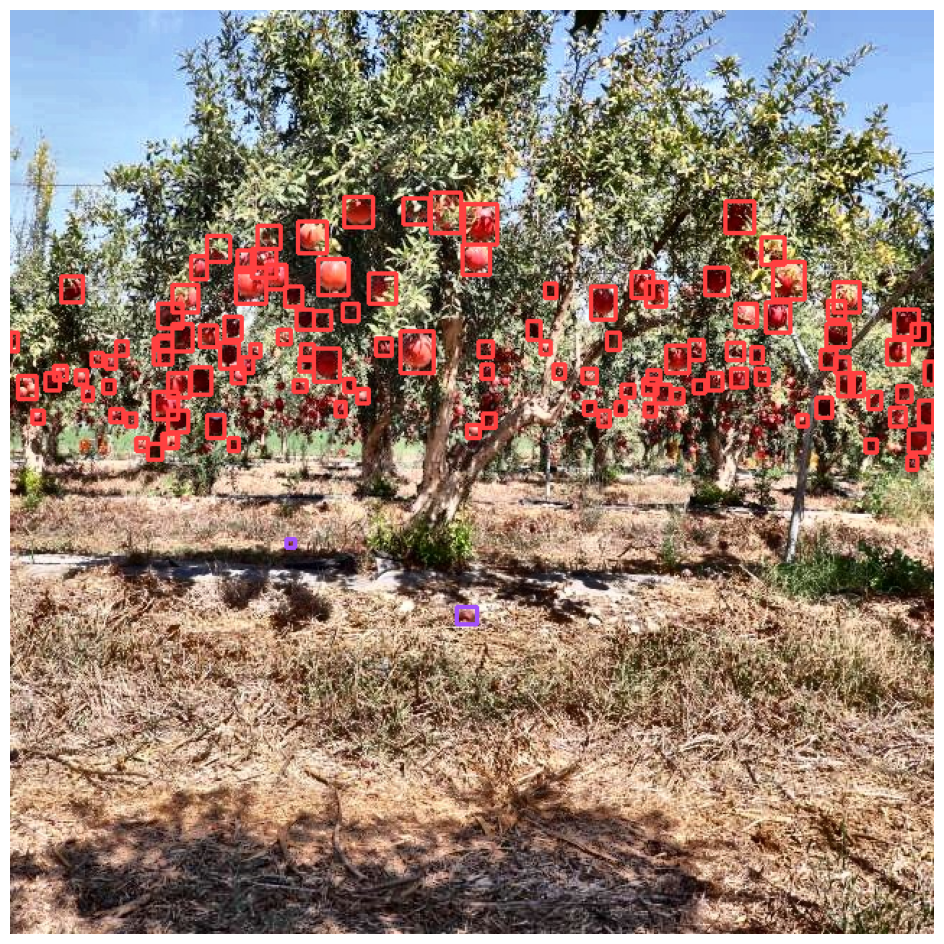


0: 640x640 7 defecteds, 117 pomegranatess, 19.3ms
Speed: 3.2ms preprocess, 19.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
/content/tzora_pomogranate_cropped-16/test/images/IMG_8478_JPG.rf.aa63b5e8d22e56ec1f5aa278e41a3ee4.jpg
<class 'supervision.detection.core.Detections'>


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


Buffered data was truncated after reaching the output size limit.

In [ ]:
#plotting the predictions
import cv2
from ultralytics import YOLO
import supervision as sv
import os

# Load the YOLO model with trained weights
#model_best = YOLO('/content/best_wieghts_YOLO.pt')
model_best=model
# Directory containing test images
test_images_path = '/content/tzora_pomogranate_cropped-16/test/images'
image_files = [os.path.join(test_images_path, f) for f in os.listdir(test_images_path) if f.endswith(('.jpg', '.png'))]

# Dictionary to hold class counts
class_counts = {}

for img_path in image_files:
    image = cv2.imread(img_path)
    results = model_best(image)[0]
    detections = sv.Detections.from_ultralytics(results)  # Convert results to Supervision detections format

     # Let's inspect what detections contains
    print(img_path)
    print(type(detections))  # Check the type

    bounding_box_annotator = sv.BoundingBoxAnnotator()
    label_annotator = sv.LabelAnnotator()

    annotated_image = bounding_box_annotator.annotate(
        scene=image, detections=detections)

    sv.plot_image(annotated_image)


In [ ]:
# Export the model's weights for future use
from google.colab import files

# Path where the best model weights are saved after training
best_model_path = '/content/runs/detect/train9/weights/best.pt'

# Trigger download to local machine
files.download(best_model_path)


#Confusion matrix and Preformance Measures



0: 640x640 4 defecteds, 42 pomegranatess, 14.9ms
Speed: 2.0ms preprocess, 14.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 10 defecteds, 105 pomegranatess, 9.9ms
Speed: 1.9ms preprocess, 9.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 15 defecteds, 67 pomegranatess, 12.9ms
Speed: 2.4ms preprocess, 12.9ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 defected, 75 pomegranatess, 10.3ms
Speed: 2.3ms preprocess, 10.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 defected, 47 pomegranatess, 10.0ms
Speed: 1.7ms preprocess, 10.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 defecteds, 34 pomegranatess, 9.9ms
Speed: 3.4ms preprocess, 9.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 20 pomegranatess, 9.7ms
Speed: 2.5ms preprocess, 9.7ms inference, 0.4ms postprocess per image at shape (1, 3,

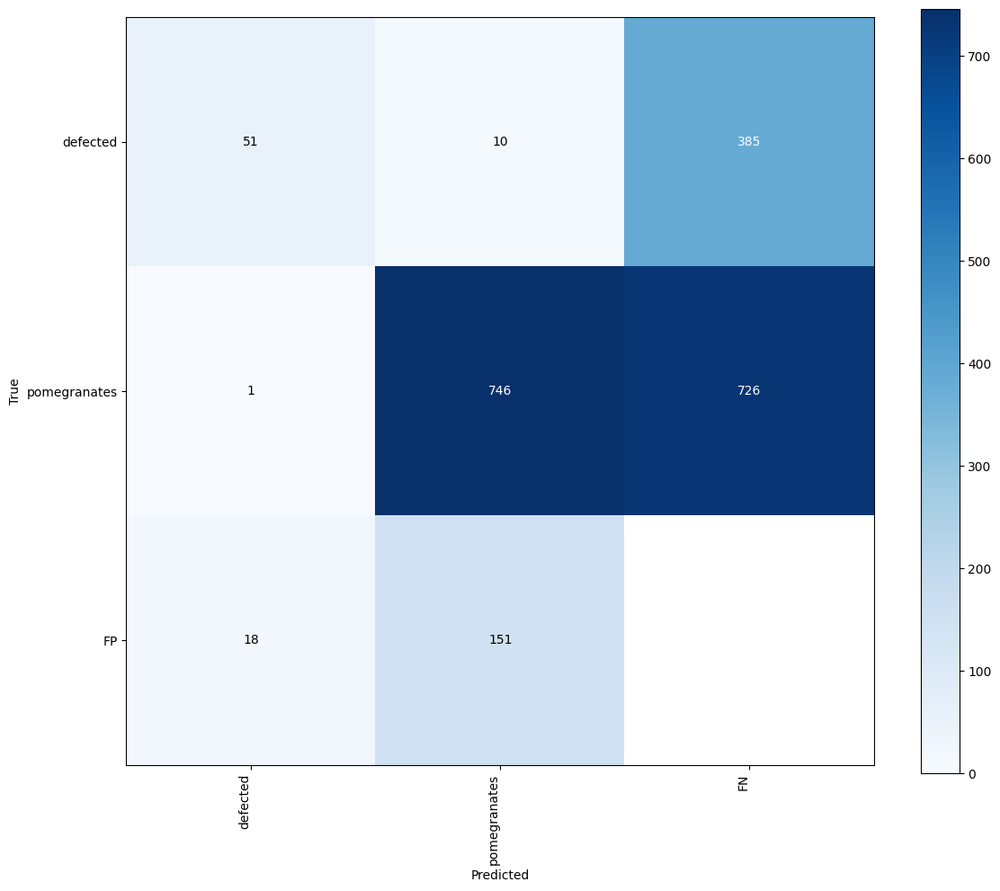

In [ ]:
dataset = sv.DetectionDataset.from_yolo(
    '/content/tzora_pomogranate_cropped-16/test/images',
    '/content/tzora_pomogranate_cropped-16/test/labels',
    '/content/tzora_pomogranate_cropped-16/data.yaml'
)

def callback(image: np.ndarray) -> sv.Detections:
    result = model_best(image)[0]
    return sv.Detections.from_ultralytics(result)

confusion_matrix = sv.ConfusionMatrix.benchmark(
   dataset = dataset,
   callback = callback,
    iou_threshold=0.5,
   conf_threshold=0.3
)

confusion_matrix.plot()
print(confusion_matrix.matrix)

In [ ]:
### culculation of matrices from confusion matrix
from sklearn.metrics import f1_score, precision_score, recall_score

matrix=confusion_matrix.matrix
class_names = confusion_matrix.classes

# Calculate Precision Manually for each class
precision_defected = matrix[0, 0] / (matrix[0, 0] + matrix[1, 0] + matrix[2, 0])
precision_pomegranate = matrix[1, 1] / (matrix[1, 1] + matrix[0, 1] + matrix[2, 1])

# Calculate Recall Manually for each class
recall_defected = matrix[0, 0] / (matrix[0, 0] + matrix[0, 1] + matrix[0, 2])
recall_pomegranate = matrix[1, 1] / (matrix[1, 1] + matrix[1, 0] + matrix[1, 2])

accuracy_defected = matrix[0, 0] / np.sum(matrix[0, :])
accuracy_pomegranate = matrix[1, 1] / np.sum(matrix[1, :])

# F1 Scores
f1_defected = 2 * (precision_defected * recall_defected) / (precision_defected + recall_defected)
f1_pomegranate = 2 * (precision_pomegranate * recall_pomegranate) / (precision_pomegranate + recall_pomegranate)

# Accuracy (overall)
accuracy = np.trace(matrix) / np.sum(matrix)

# Macro Average Precision, Recall, F1
overall_precision = np.mean([precision_defected, precision_pomegranate])
overall_recall = np.mean([recall_defected, recall_pomegranate])
overall_f1 = np.mean([f1_defected, f1_pomegranate])

# Output the results
print(f'Class "Defected": Precision: {precision_defected:.4f}, Recall: {recall_defected:.4f}, F1 Score: {f1_defected:.4f}')
print(f'Class "Pomegranate": Precision: {precision_pomegranate:.4f}, Recall: {recall_pomegranate:.4f}, F1 Score: {f1_pomegranate:.4f}')
print(f'Accuracy for Class "Defected": {accuracy_defected:.4f}')
print(f'Accuracy for Class "Pomegranate": {accuracy_pomegranate:.4f}')
print(f'Overall Precision: {overall_precision:.4f}')
print(f'Overall Recall: {overall_recall:.4f}')
print(f'Overall F1 Score: {overall_f1:.4f}')
print(f'Overall Accuracy: {accuracy:.4f}')

Class "Defected": Precision: 0.7286, Recall: 0.1143, F1 Score: 0.1977
Class "Pomegranate": Precision: 0.8225, Recall: 0.5064, F1 Score: 0.6269
Accuracy for Class "Defected": 0.1143
Accuracy for Class "Pomegranate": 0.5064
Overall Precision: 0.7755
Overall Recall: 0.3104
Overall F1 Score: 0.4123
Overall Accuracy: 0.3817


[[    0.11435    0.022422     0.86323]
 [ 0.00067889     0.50645     0.49287]
 [    0.10651     0.89349           0]]


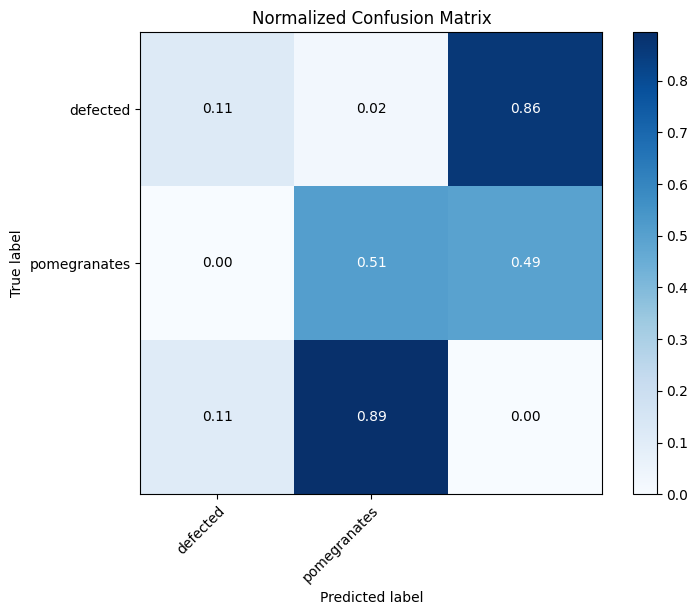

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#normelized confusion matrix
def plot_normalized_confusion_matrix(confusionMatrix):
    # Extract the matrix and classes from the ConfusionMatrix object
    cm_data = confusionMatrix.matrix
    classes = confusionMatrix.classes

    # Normalize the confusion matrix by row sums (i.e., actual class totals)
    row_sums = cm_data.sum(axis=1, keepdims=True)
    normalized_matrix = cm_data / row_sums
    print(normalized_matrix)
    confusionMatrix.matrix = normalized_matrix
    # Plot the normalized confusion matrix
    # Create a heatmap to visualize the normalized confusion matrix
    fig, ax = plt.subplots(figsize=(8, 6))
    cmap = plt.cm.Blues  # Color map for the heatmap
    im = ax.imshow(normalized_matrix, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)  # Add a colorbar to a plot

    # Adding title and labels to the plot
    ax.set(xticks=np.arange(len(classes)),
           yticks=np.arange(len(classes)),
           xticklabels=classes,  # Class labels for predicted (x-axis)
           yticklabels=classes,  # Class labels for true (y-axis)
           title='Normalized Confusion Matrix',
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels for better visibility
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    thresh = normalized_matrix.max() / 2.
    for i in range(normalized_matrix.shape[0]):
        for j in range(normalized_matrix.shape[1]):
            ax.text(j, i, format(normalized_matrix[i, j], '.2f'),
                    ha="center", va="center",
                    color="white" if normalized_matrix[i, j] > thresh else "black")

    plt.show()
plot_normalized_confusion_matrix(confusion_matrix)


#visualising differences between models